In [22]:
import numpy as np
import pandas as pd
import warnings
import os

# Visualization
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

# Setting parameters
pd.set_option('display.max_columns', 100)
warnings.filterwarnings('ignore')
plt.style.use('fivethirtyeight')
%matplotlib inline

In [2]:
# Loading dataset
train_df = pd.read_csv('training.csv', index_col='id')

## Variable Identification

To start with, we will identify data types and categories of each variable.

In [3]:
train_df.head()

,posted_time,updated_time,age,updated_age,app_type,owner_id,owner_type,owner_influence,number_of_likes,number_of_comments,reactivity,is_mentions_me,is_mentions_connections,is_commented_by_me,is_commented_by_connections,is_liked_by_me,is_liked_by_connections,poster_id,poster_gender,poster_is_employee,poster_is_lead,poster_is_in_connections,poster_focus,poster_order,poster_influence,participant1_id,participant1_action,participant1_gender,participant1_is_employee,participant1_is_lead,participant1_is_in_connections,participant1_focus,participant1_order,participant1_influence,participant2_id,participant2_action,participant2_gender,participant2_is_employee,participant2_is_lead,participant2_is_in_connections,participant2_focus,participant2_order,participant2_influence,participant3_id,participant3_action,participant3_gender,participant3_is_employee,participant3_is_lead,participant3_is_in_connections,participant3_focus,participant3_order,participant3_influence,participant4_id,participant4_action,participant4_gender,participant4_is_employee,participant4_is_lead,participant4_is_in_connections,participant4_focus,participant4_order,participant4_influence,participant5_id,participant5_action,participant5_gender,participant5_is_employee,participant5_is_lead,participant5_is_in_connections,participant5_focus,participant5_order,participant5_influence,rank
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
175339,1.514050e+12,1.514050e+12,6.315242e+10,6.315242e+10,other,57727,space,0.99973,1,0,1.00000,0,0,0,0,0,1,5,male,1,0,1,marketing,6,0.99962,146,liked,male,1,0,1,marketing,5,0.99899,22636,viewed,male,0,0,1,other,4,0.23077,3080,viewed,male,0,0,1,marketing,3,0.23077,44661,viewed,male,0,0,1,other,2,0.23077,3089,viewed,male,0,0,1,other,1,0.23077,0.73677
175348,1.514110e+12,1.515160e+12,6.309278e+10,6.204696e+10,forum,111913,space,0.99977,0,2,0.12336,0,0,0,1,0,0,146,male,1,0,1,marketing,6,0.99899,13659,commented,male,0,0,0,other,5,0.99756,146,commented,male,1,0,1,marketing,4,0.99899,22636,viewed,male,0,0,1,other,3,0.23077,3080,viewed,male,0,0,1,marketing,2,0.23077,44661,viewed,male,0,0,1,other,1,0.23077,0.78240
175353,1.514120e+12,1.515160e+12,6.309049e+10,6.204716e+10,forum,111913,space,0.99977,0,3,0.12336,0,0,0,1,0,0,146,male,1,0,1,marketing,6,0.99899,13659,commented,male,0,0,0,other,5,0.99756,13,commented,male,1,0,1,marketing,4,0.99895,146,commented,male,1,0,1,marketing,3,0.99899,22636,viewed,male,0,0,1,other,2,0.23077,3080,viewed,male,0,0,1,marketing,1,0.23077,0.82125
175371,1.514190e+12,1.514190e+12,6.301324e+10,6.301324e+10,other,9037,space,0.99949,0,0,0.00000,0,0,0,0,0,0,7,male,1,0,1,marketing,6,0.99886,22636,viewed,male,0,0,1,other,5,0.23077,3080,viewed,male,0,0,1,marketing,4,0.23077,44661,viewed,male,0,0,1,other,3,0.23077,3089,viewed,male,0,0,1,other,2,0.23077,3084,viewed,male,0,0,1,marketing,1,0.23077,0.61522
175372,1.514190e+12,1.514190e+12,6.301323e+10,6.301323e+10,other,9037,space,0.99949,0,0,0.00000,0,0,0,0,0,0,7,male,1,0,1,marketing,6,0.99886,22636,viewed,male,0,0,1,other,5,0.23077,3080,viewed,male,0,0,1,marketing,4,0.23077,44661,viewed,male,0,0,1,other,3,0.23077,3089,viewed,male,0,0,1,other,2,0.23077,3084,viewed,male,0,0,1,marketing,1,0.23077,0.61522


In [4]:
# Split features into input and output categories
predictor = train_df.drop('rank', axis=1)
target = train_df['rank']

In [5]:
# Identify data type of the input variables
num_cols = [col for col in predictor.columns if predictor[col].dtype in ('int64', 'float64')]
str_cols = [col for col in predictor.columns if predictor[col].dtype == 'object']

print("Number of numerical columns: {}.".format(len(num_cols)))
print("Number of string columns: {}.".format(len(str_cols)))

Number of numerical columns: 51.
Number of string columns: 19.


In [6]:
# Watching how many unique values are in each column
for col in predictor.columns:
    print("{:30} column has {} unique values.".format(col, predictor[col].nunique()))

posted_time                    column has 2688 unique values.
updated_time                   column has 2671 unique values.
age                            column has 9398 unique values.
updated_age                    column has 9398 unique values.
app_type                       column has 6 unique values.
owner_id                       column has 173 unique values.
owner_type                     column has 2 unique values.
owner_influence                column has 48 unique values.
number_of_likes                column has 59 unique values.
number_of_comments             column has 39 unique values.
reactivity                     column has 31 unique values.
is_mentions_me                 column has 2 unique values.
is_mentions_connections        column has 2 unique values.
is_commented_by_me             column has 2 unique values.
is_commented_by_connections    column has 2 unique values.
is_liked_by_me                 column has 2 unique values.
is_liked_by_connections        column 

In [7]:
# Double-checking columns that have 10 <= unique values < 100
suspicious = ['owner_influence', 'number_of_likes', 'number_of_comments', 'reactivity']

for col in suspicious:
    print("Unique values in '{}' column:".format(col))
    print(np.sort(predictor[col].unique()), end="\n\n")

Unique values in 'owner_influence' column:
[0.1     0.44444 0.5     0.64286 0.74359 0.79592 0.81132 0.81481 0.85915
 0.86486 0.88636 0.89796 0.90099 0.90909 0.91736 0.92308 0.92537 0.93056
 0.93197 0.93939 0.93976 0.94413 0.95169 0.95475 0.95633 0.95726 0.95745
 0.95798 0.96364 0.96785 0.96795 0.97101 0.97462 0.97613 0.98088 0.98224
 0.98761 0.98821 0.99655 0.99819 0.99882 0.99923 0.99937 0.99949 0.99973
 0.99977 0.9998  0.99992]

Unique values in 'number_of_likes' column:
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 50 52 53 54 55 56 58 59 61 63 64]

Unique values in 'number_of_comments' column:
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  30  31  39  44  46  53 105
 114 136 145]

Unique values in 'reactivity' column:
[0.         0.05951799 0.06136305 0.06332817 0.06542562 0.0676694
 0.07007559 0.07266273 0.0754

We see that these columns are not categorical and should be treated simply as numerical.

Also, I am a bit suspicious of 'owner_influence' and 'reactivity' columns: 

    1) 'owner_influence' has no values in range [0.1, 0.444];
    2) 'reactivity' has no values in range [0.51, 1].
    
From description of the data we know that 'reactivity' column is a part of our label column, 'rank'. So, we should ignore it in future exploration.

In [8]:
# Saving all columns with number of unique values less than 31 as 'categorical' variables.
cat_cols = []  # categorical columns
cnt_cols = []  # continuous columns
for col in predictor.columns:
    if predictor[col].nunique() < 31:
        cat_cols.append(col)
    else:
        cnt_cols.append(col)

In [9]:
# Looking closer at all categorical columns.
for col in cat_cols:
    print("{:-<30s}--> {}".format(col, predictor[col].unique()))

app_type------------------------> ['other' 'forum' 'wiki' 'calendar' 'poll' 'social']
owner_type----------------------> ['space' 'user']
is_mentions_me------------------> [0 1]
is_mentions_connections---------> [0 1]
is_commented_by_me--------------> [0 1]
is_commented_by_connections-----> [0 1]
is_liked_by_me------------------> [0 1]
is_liked_by_connections---------> [1 0]
poster_gender-------------------> ['male' 'female']
poster_is_employee--------------> [1 0]
poster_is_lead------------------> [0]
poster_is_in_connections--------> [1 0]
poster_focus--------------------> ['marketing' 'other' 'engineering' 'sales' 'none']
poster_order--------------------> [6]
participant1_action-------------> ['liked' 'commented' 'viewed']
participant1_gender-------------> ['male' 'female']
participant1_is_employee--------> [1 0]
participant1_is_lead------------> [0]
participant1_is_in_connections--> [1 0]
participant1_focus--------------> ['marketing' 'other' 'engineering' 'sales']
participant1_orde

Because of incompleteness of the dataset, we see many columns where there is only one unique value. These features should be ignored in our work.

Also, we don't need 'id' columns, they will not give us useful insights.

In [10]:
ignored_features = ['reactivity', 'poster_id', 'poster_is_lead', 'poster_order', 'owner_id',
                    'participant1_id', 'participant1_is_lead', 'participant1_order',
                    'participant2_id', 'participant2_is_lead', 'participant2_order',
                    'participant3_id', 'participant3_is_lead', 'participant3_order',
                    'participant4_id', 'participant4_is_lead', 'participant4_order',
                    'participant5_id', 'participant5_is_lead', 'participant5_order',]

predictor = predictor.drop(ignored_features, axis=1)

## Univariate Analysis

- In case of continuous data we will show distribution plots.
- In case of categorical data we will show barplots.

You can see an example below.

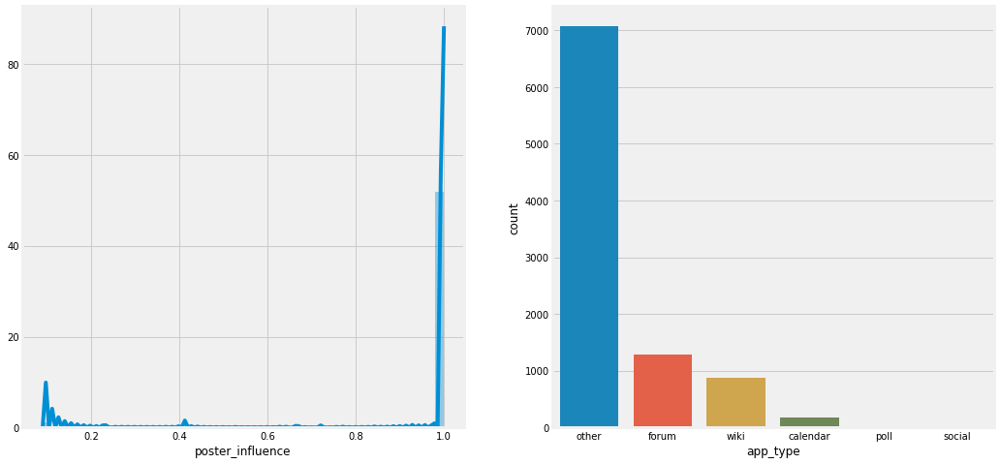

In [11]:
fig, axs = plt.subplots(ncols=2, figsize=(16, 8))
sns.distplot(a=predictor['poster_influence'], ax=axs[0])  # for numerical
sns.countplot(x='app_type', data=predictor, ax=axs[1])  # for categorical
plt.savefig('eda_results/univariate/example.png')

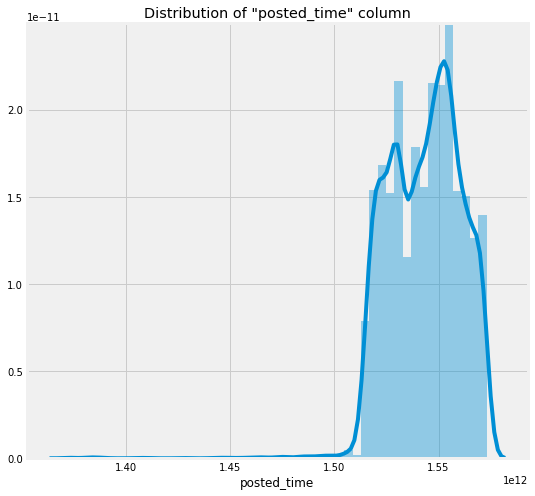

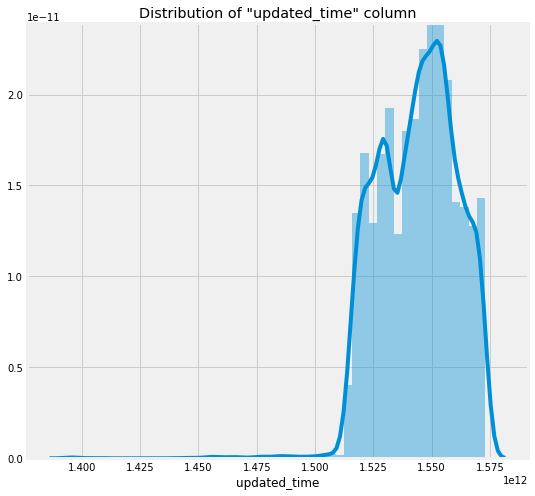

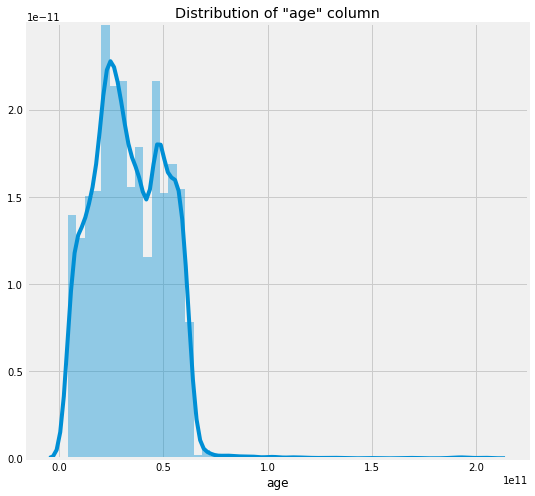

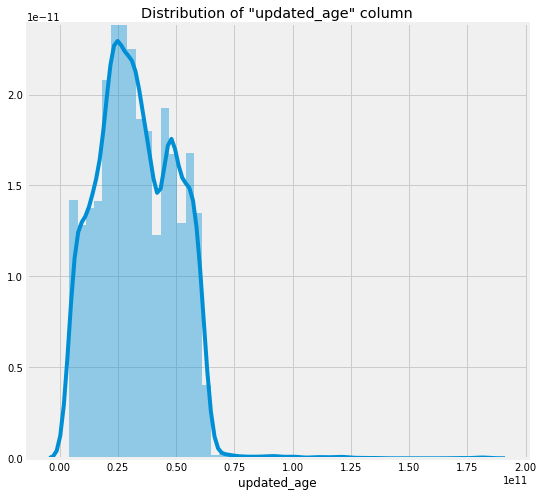

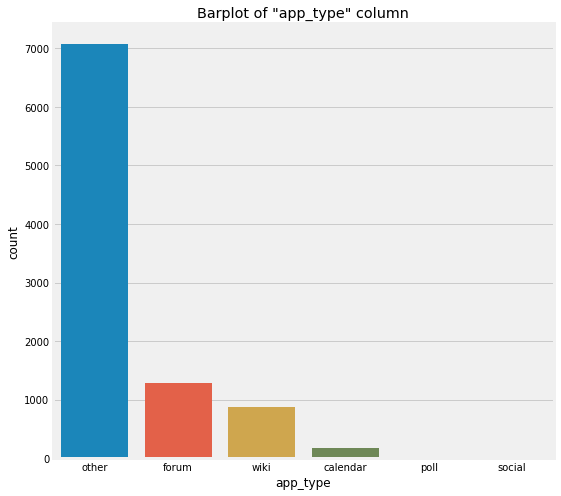

...

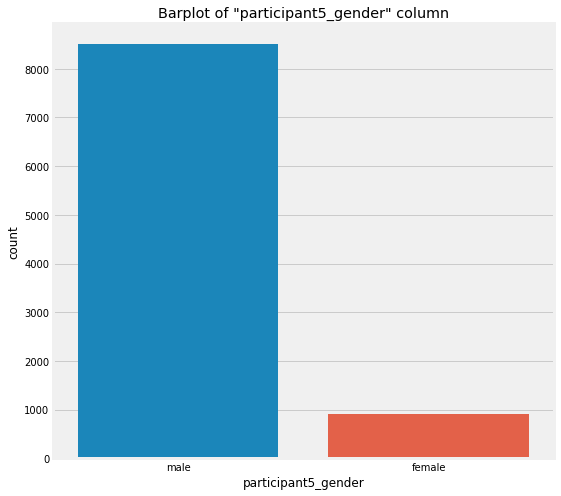

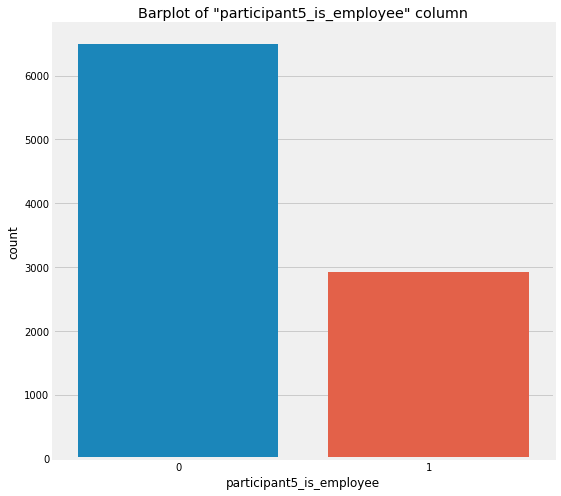

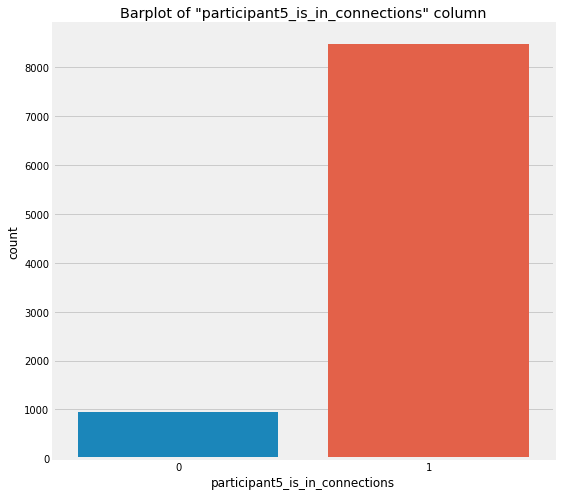

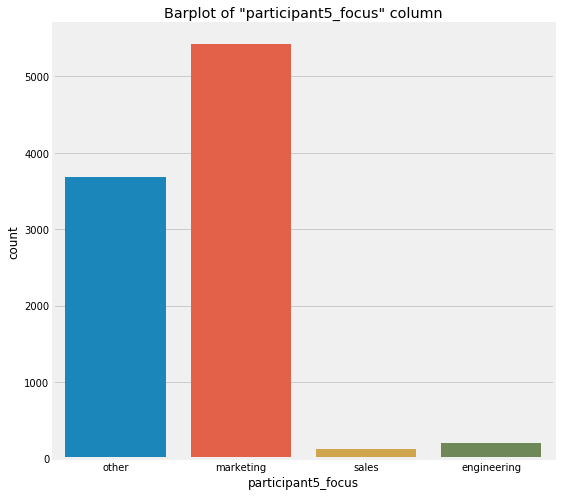

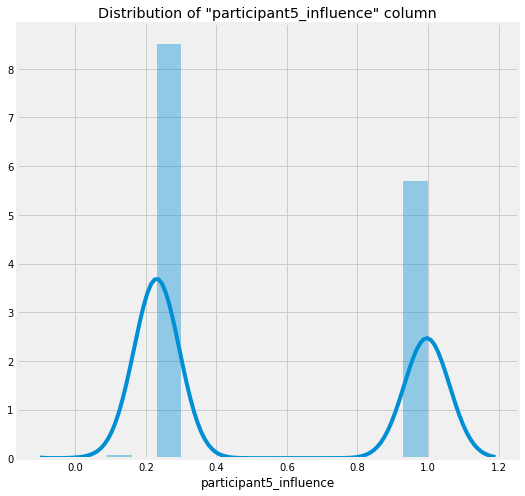

In [12]:
for col in predictor.columns:
    plt.figure(figsize=(8, 8))
    if col in cnt_cols:  # continuous
        plt.title('Distribution of "{}" column'.format(col))
        sns.distplot(a=predictor[col])
        plt.savefig('eda_results/univariate/{}.png'.format(col))
    elif col in cat_cols:  # categorical
        plt.title('Barplot of "{}" column'.format(col))
        sns.countplot(x=col, data=predictor)
        plt.savefig('eda_results/univariate/{}.png'.format(col))

## Bivariate Analysis

To show relationships between different variables we will use:

- Scatter plot for relationship between continuous and continuous;
- Double bar plot for relationship between categorical and categorical;
- Bar plot for relationship between continuous and categorical.

You can see an example below.

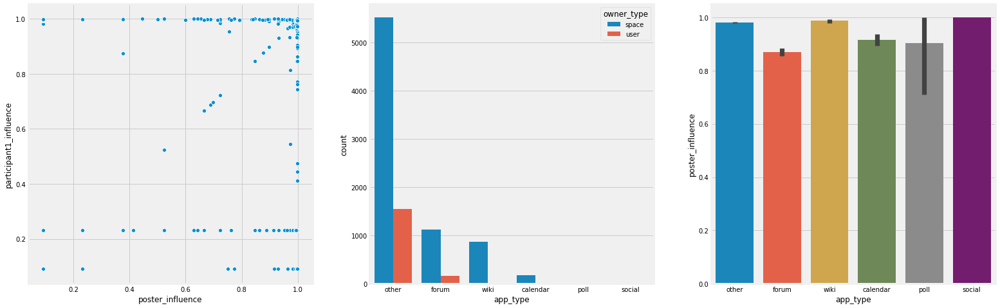

In [13]:
fig, axs = plt.subplots(ncols=3, figsize=(24, 8))
sns.scatterplot(x='poster_influence', y='participant1_influence', data=predictor, 
                ax=axs[0])  # continuous x continuous
sns.countplot(x='app_type', hue='owner_type', data=predictor, 
              ax=axs[1])  # for categorical x categorical
sns.barplot(x='app_type', y='poster_influence', data=predictor,
            ax=axs[2])  # for continuous x categorical
plt.savefig('eda_results/bivariate/example.png')

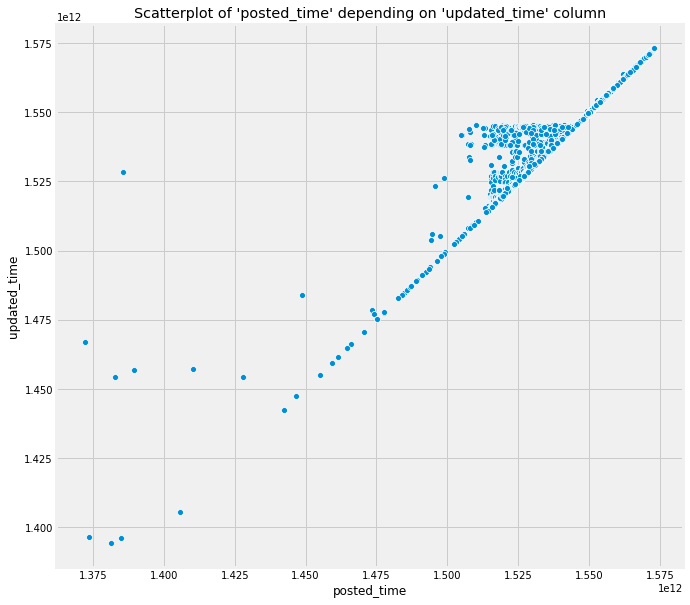

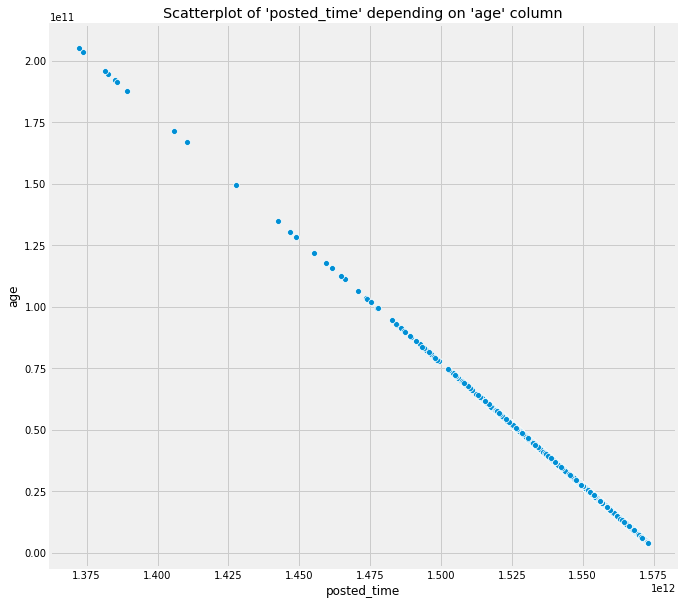

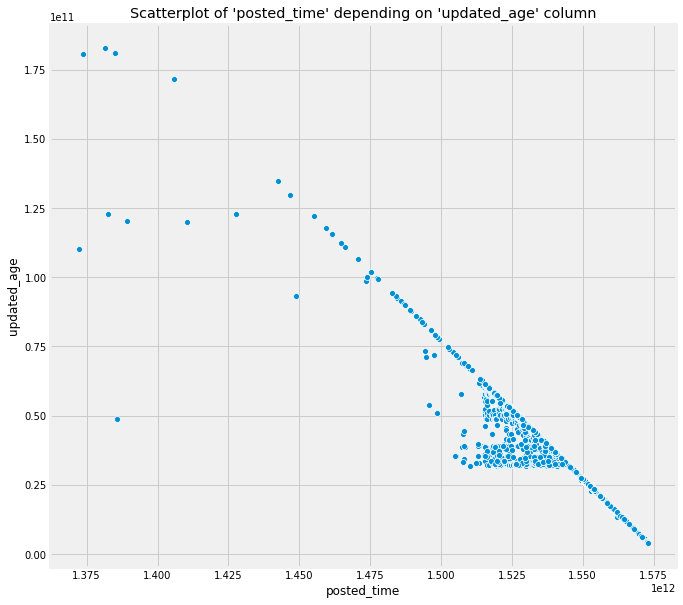

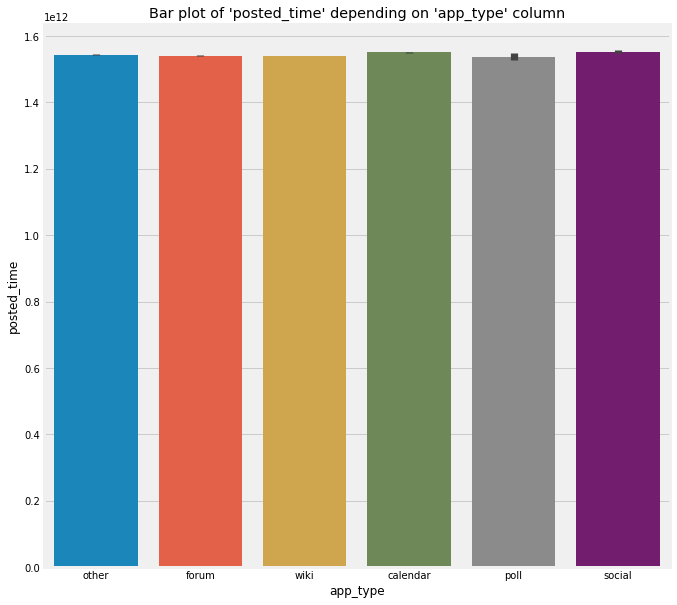

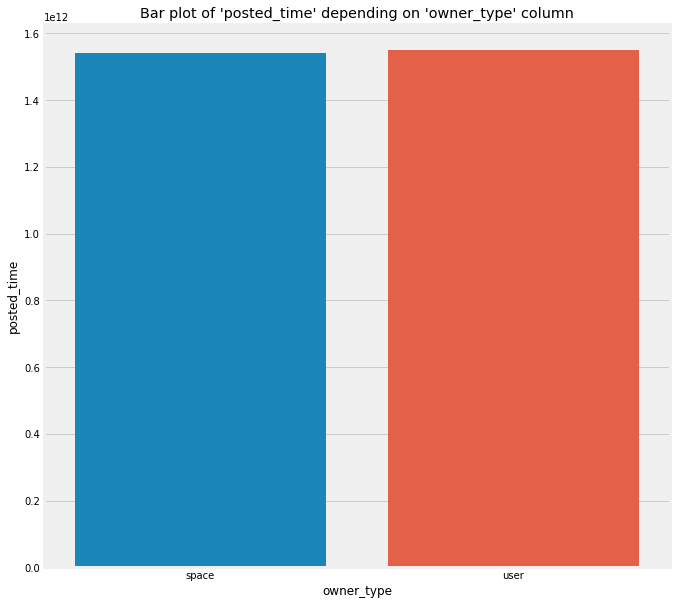

...

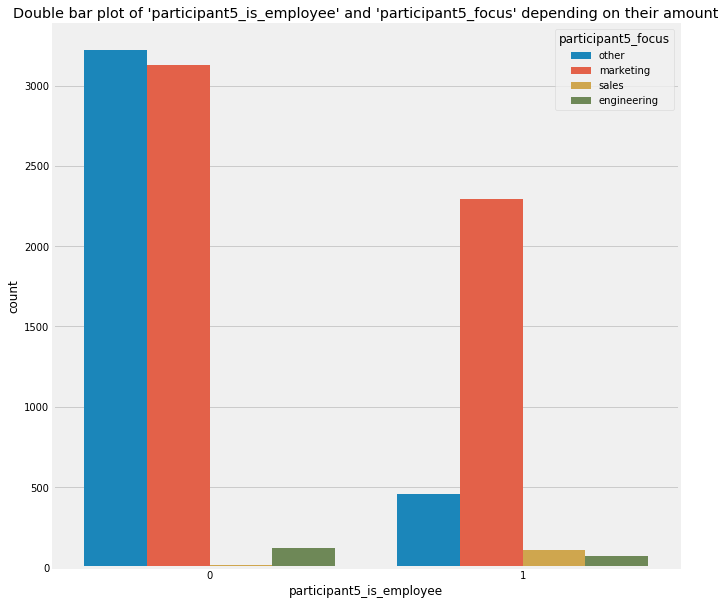

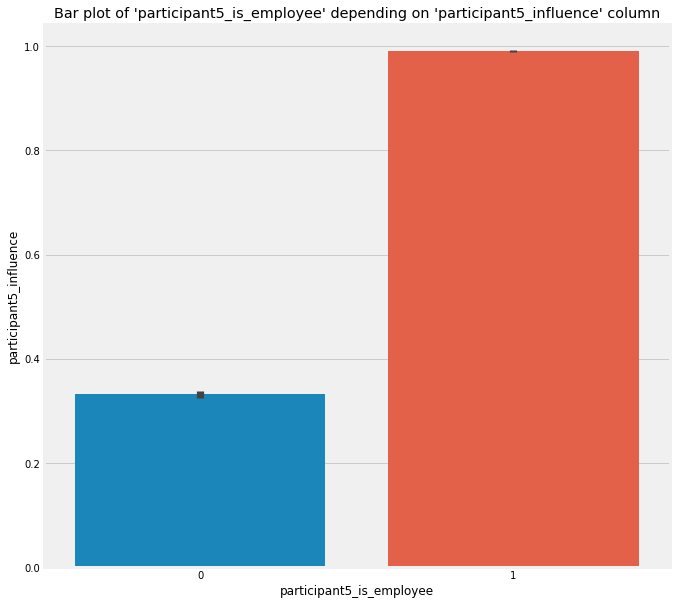

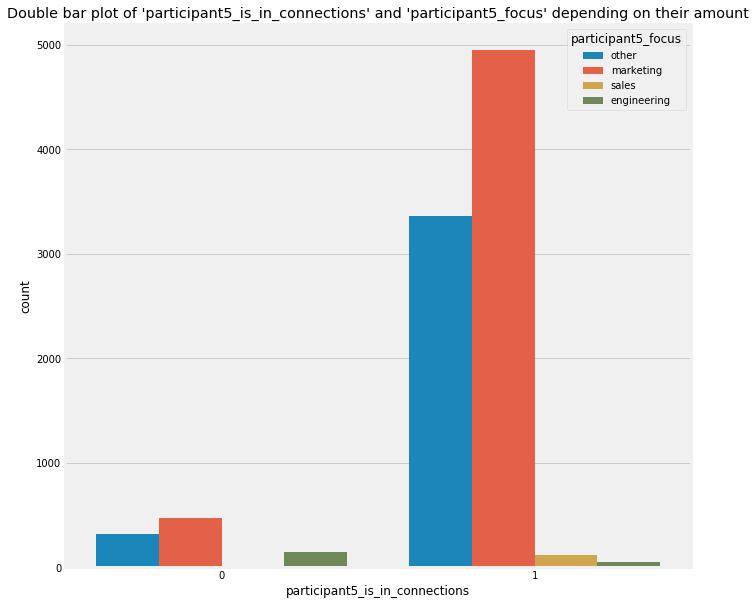

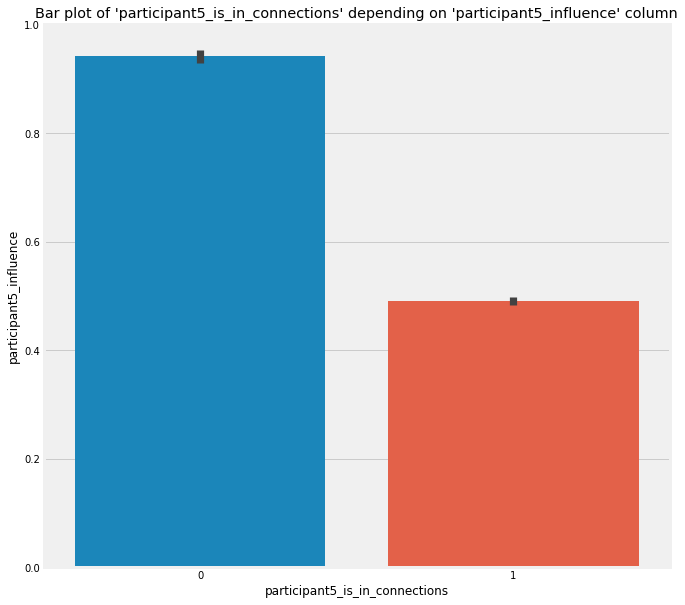

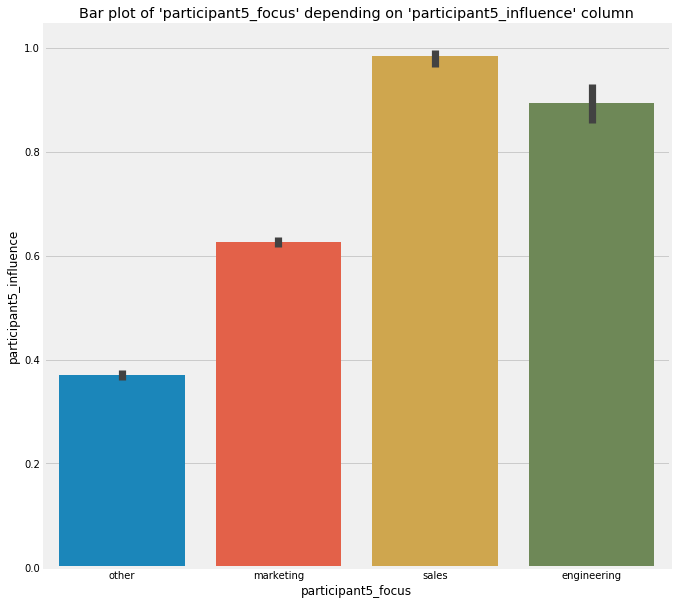

In [25]:
n = len(predictor.columns)
for i in range(n):
    os.makedirs('eda_results/bivariate/{}'.format(predictor.columns[i]), exist_ok=True)
    for j in range(i+1, n):
        cols = (predictor.columns[i], predictor.columns[j])
        is_in_cont = [k in cnt_cols for k in cols]
        
        plt.figure(figsize=(10, 10))
        if all(is_in_cont):  # continuous x continuous
            plt.title("Scatterplot of '{0}' depending on '{1}' column".format(*cols))
            sns.scatterplot(x=cols[0], y=cols[1], data=predictor)
        elif any(is_in_cont):  # continuous x categorical
            plt.title("Bar plot of '{0}' depending on '{1}' column".format(*cols))
            if cols[1] in cat_cols:
                sns.barplot(x=cols[1], y=cols[0], data=predictor)
            else:
                sns.barplot(x=cols[0], y=cols[1], data=predictor)
        else:  # categorical x categorical
            plt.title("Double bar plot of '{0}' and '{1}' depending on their amount".format(*cols))
            sns.countplot(x=cols[0], hue=cols[1], data=predictor)
        plt.savefig('eda_results/bivariate/{0}/{0}_x_{1}.png'.format(*cols))